<a href="https://colab.research.google.com/github/DavidLi1355/music_generation/blob/master/6S191_lab1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Part 1

In [ ]:
!pip install mitdeeplearning
import mitdeeplearning as mdl

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
sport = tf.constant("Tennis", tf.string)
number = tf.constant(1.41421356237, tf.float64)

print("`sport` is a {}-d Tensor".format(tf.rank(sport).numpy()))
print("`number` is a {}-d Tensor".format(tf.rank(number).numpy()))

`sport` is a 0-d Tensor
`number` is a 0-d Tensor


In [ ]:
sports = tf.constant(["Tennis", "Basketball"], tf.string)
numbers = tf.constant([3.141592, 1.414213, 2.71821], tf.float64)

print("`sports` is a {}-d Tensor with shape: {}".format(tf.rank(sports).numpy(), tf.shape(sports)))
print("`numbers` is a {}-d Tensor with shape: {}".format(tf.rank(numbers).numpy(), tf.shape(numbers)))

`sports` is a 1-d Tensor with shape: [2]
`numbers` is a 1-d Tensor with shape: [3]


In [ ]:
### Defining higher-order Tensors ###

'''TODO: Define a 2-d Tensor'''
matrix = tf.constant([[1, 2, 3], [4, 5, 6]], tf.int16)

assert isinstance(matrix, tf.Tensor), "matrix must be a tf Tensor object"
assert tf.rank(matrix).numpy() == 2
print(tf.shape(matrix)[-1])

tf.Tensor(3, shape=(), dtype=int32)


In [ ]:
'''TODO: Define a 4-d Tensor.'''
# Use tf.zeros to initialize a 4-d Tensor of zeros with size 10 x 256 x 256 x 3. 
#   You can think of this as 10 images where each image is RGB 256 x 256.
images = tf.zeros([10, 256, 256, 3])

assert isinstance(images, tf.Tensor), "matrix must be a tf Tensor object"
assert tf.rank(images).numpy() == 4, "matrix must be of rank 4"
assert tf.shape(images).numpy().tolist() == [10, 256, 256, 3], "matrix is incorrect shape"

In [ ]:
row_vector = matrix[1]
column_vector = matrix[:,2]
scalar = matrix[1, 2]

print("`row_vector`: {}".format(row_vector.numpy()))
print("`column_vector`: {}".format(column_vector.numpy()))
print("`scalar`: {}".format(scalar.numpy()))

`row_vector`: [4 5 6]
`column_vector`: [3 6]
`scalar`: 6


In [ ]:
# Create the nodes in the graph, and initialize values
a = tf.constant(15)
b = tf.constant(61)

# Add them!
c1 = tf.add(a,b)
c2 = a + b # TensorFlow overrides the "+" operation so that it is able to act on Tensors
print(c1)
print(c2)

tf.Tensor(76, shape=(), dtype=int32)
tf.Tensor(76, shape=(), dtype=int32)


In [ ]:
### Defining Tensor computations ###

# Construct a simple computation function
def func(a,b):
  '''TODO: Define the operation for c, d, e (use tf.add, tf.subtract, tf.multiply).'''
  c = tf.add(a, b)
  d = tf.subtract(b, tf.ones(tf.shape(b)))
  e = tf.multiply(c, d)
  return e

In [ ]:
# Consider example values for a,b
a, b = 1.5, 2.5
# Execute the computation
e_out = func(a,b)
print(e_out)

tf.Tensor(6.0, shape=(), dtype=float32)


In [ ]:
### Defining a network Layer ###

# n_output_nodes: number of output nodes
# input_shape: shape of the input
# x: input to the layer

class OurDenseLayer(tf.keras.layers.Layer):
  def __init__(self, n_output_nodes):
    super(OurDenseLayer, self).__init__()
    self.n_output_nodes = n_output_nodes
  
  def build(self, input_shape):
    d = int(input_shape[-1])
    # Define and initialize parameters: a weight matrix W and bias b
    # Note that parameter initialization is random!
    self.W = self.add_weight("weight", shape=[d, self.n_output_nodes])
    self.b = self.add_weight("bias", shape=[1, self.n_output_nodes])

  def call(self, x):
    z = tf.add(tf.matmul(x, self.W), self.b)
    y = tf.sigmoid(z)
    return y

# Since layer parameters are initialized randomly, we will set a random seed for reproducibility
tf.random.set_seed(1)
layer = OurDenseLayer(3)
layer.build((1, 2))
x_input = tf.constant([[1, 2.]], shape=(1,2))
y = layer.call(x_input) 

# test the output!
print(tf.shape(y))
print(y.numpy())
mdl.lab1.test_custom_dense_layer_output(y)

tf.Tensor([1 3], shape=(2,), dtype=int32)
[[0.26978594 0.45750415 0.66536945]]
[PASS] test_custom_dense_layer_output


True

In [ ]:
### Defining a neural network using the Sequential API ###

# Import relevant packages
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense

# Define the number of outputs
n_output_nodes = 3

# First define the model
model = Sequential()

'''TODO: Define a dense (fully connected) layer to compute z'''
# Remember: dense layers are defined by the parameters W and b!
# You can read more about the initialization of W and b in the TF documentation :) 
# https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense?version=stable
dense_layer = Dense(n_output_nodes)

# Add the dense layer to the model
model.add(dense_layer)

In [ ]:
# Test model with example input 
x_input = tf.constant([[1,2.]], shape=(1,2))

model_output = model(x_input).numpy()
print(model_output)

[[ 0.24415088  0.6485772  -1.9461871 ]]


In [ ]:
### Defining a model using subclassing ###

from tensorflow.keras import Model
from tensorflow.keras.layers import Dense

class SubclassModel(tf.keras.Model):
  def __init__(self, n_output_nodes):
    super(SubclassModel, self).__init__()
    self.dense_layer = Dense(n_output_nodes)

  def call(self, inputs):
    return self.dense_layer(inputs)

In [ ]:
n_output_nodes = 3
model = SubclassModel(n_output_nodes)

x_input = tf.constant([[1,2.]], shape=(1,2))

print(model.call(x_input))

tf.Tensor([[ 0.62118787 -0.08692831  1.6387595 ]], shape=(1, 3), dtype=float32)


In [ ]:
### Defining a model using subclassing and specifying custom behavior ###

from tensorflow.keras import Model
from tensorflow.keras.layers import Dense

class IdentityModel(tf.keras.Model):
  def __init__(self, n_output_nodes):
    super(IdentityModel, self).__init__()
    self.dense_layer = Dense(n_output_nodes)

  def call(self, inputs, isidentity=False):
    if isidentity:
      return inputs
    else:
      return self.dense_layer(inputs)

In [ ]:
n_output_nodes = 3
model = IdentityModel(n_output_nodes)

x_input = tf.constant([[1,2.]], shape=(1,2))
out_activate = model.call(x_input)
out_identity = model.call(x_input, isidentity=True)

print("Network output with activation: {}; network identity output: {}".format(out_activate.numpy(), out_identity.numpy()))

Network output with activation: [[ 2.362289  -0.7232647  1.6525304]]; network identity output: [[1. 2.]]


In [ ]:
### Gradient computation with GradientTape ###

# y = x^2
# Example: x = 3.0
x = tf.Variable(3.0)

# Initiate the gradient tape
with tf.GradientTape() as tape: 
  # Define the function
  y = x * x

# Access the gradient -- derivative of y with respect to x
dy_dx = tape.gradient(y, x)

assert dy_dx.numpy() == 6.0

Initializing x=[[-1.0416911]]


Text(0, 0.5, 'x value')

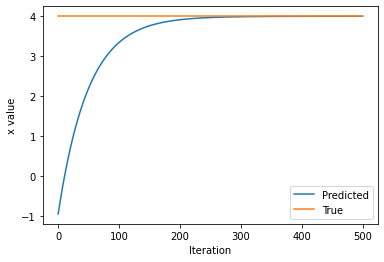

In [ ]:
### Function minimization with automatic differentiation and SGD ###

# Initialize a randome value for our initial x
x = tf.Variable([tf.random.normal([1])])
print("Initializing x={}".format(x.numpy()))

learning_rate = 1e-2
history = []
x_f = 4

for i in range(500):
  with tf.GradientTape() as tape:
    loss = (x - x_f) ** 2
  
  gradient = tape.gradient(loss, x)
  new_x = x - learning_rate * gradient
  x.assign(new_x)
  history.append(x.numpy()[0][0])


# Plot the evolution of x as we optimize towards x_f!
plt.plot(history)
plt.plot([0, 500],[x_f,x_f])
plt.legend(('Predicted', 'True'))
plt.xlabel('Iteration')
plt.ylabel('x value')

Part 2

In [ ]:
import tensorflow as tf
!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

In [ ]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [ ]:
# Convert the ABC notation to audio file 
mdl.lab1.play_song(example_song)

In [ ]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
print(vocab)
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

['\n', ' ', '!', '"', '#', "'", '(', ')', ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', '<', '=', '>', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', '[', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '|']
There are 83 unique characters in the dataset


In [ ]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d", 
#   we can evaluate `char2idx["d"]`.  
char2idx = {u:i for i, u in enumerate(vocab)}

#char2idx = {u:i for i, u in enumerate(vocab)}
print(char2idx['\n'])

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)
print(idx2char)

0
['\n' ' ' '!' '"' '#' "'" '(' ')' ',' '-' '.' '/' '0' '1' '2' '3' '4' '5'
 '6' '7' '8' '9' ':' '<' '=' '>' 'A' 'B' 'C' 'D' 'E' 'F' 'G' 'H' 'I' 'J'
 'K' 'L' 'M' 'N' 'O' 'P' 'Q' 'R' 'S' 'T' 'U' 'V' 'W' 'X' 'Y' 'Z' '[' ']'
 '^' '_' 'a' 'b' 'c' 'd' 'e' 'f' 'g' 'h' 'i' 'j' 'k' 'l' 'm' 'n' 'o' 'p'
 'q' 'r' 's' 't' 'u' 'v' 'w' 'x' 'y' 'z' '|']


In [ ]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [ ]:

### Vectorize the songs string ###

'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function 
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''

def vectorize_string(string):
  temp = []
  for char in string:
    temp.append(char2idx[char])
  return np.array(temp)

print(len(songs_joined))
vectorized_songs = vectorize_string(songs_joined)
print(vectorized_songs.shape)

200425
(200425,)


In [ ]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]


In [ ]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch as an array with shape of batch_size
  idx = np.random.choice(n - seq_length, batch_size)

  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1:i+seq_length+1] for i in idx]

  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])

  return x_batch, y_batch


# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, 5, 1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
  print("Step {:3d}".format(i))
  print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
  print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 58 ('c')
  expected output: 26 ('A')
Step   1
  input: 26 ('A')
  expected output: 1 (' ')
Step   2
  input: 1 (' ')
  expected output: 32 ('G')
Step   3
  input: 32 ('G')
  expected output: 30 ('E')
Step   4
  input: 30 ('E')
  expected output: 29 ('D')


In [ ]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      recurrent_initializer='glorot_uniform',
      return_sequences=True,
      stateful=True
  )

In [ ]:
### Defining the RNN model ###

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    LSTM(rnn_units),
    tf.keras.layers.Dense(vocab_size)           
  ])
  
  return model

# Build a simple model with default hyperparameters. You will get the 
#   chance to change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

['\n', ' ', '!', '"', '#', "'", '(', ')', ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', '<', '=', '>', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', '[', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '|']


In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (32, None, 256)           21248     
_________________________________________________________________
lstm_1 (LSTM)                (32, None, 1024)          5246976   
_________________________________________________________________
dense_1 (Dense)              (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")
print(pred[0])

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)
tf.Tensor(
[[-0.00477158 -0.00125176 -0.00654596 ... -0.00326623 -0.00271142
  -0.00156619]
 [-0.00101827 -0.00694884 -0.00584759 ...  0.00221558  0.00418822
   0.0032107 ]
 [-0.0029918  -0.00166699 -0.01042765 ...  0.00375851  0.00127495
   0.00334128]
 ...
 [ 0.00034329  0.00338224 -0.00590582 ... -0.00085726 -0.00630816
  -0.00962742]
 [-0.00207338  0.00720113 -0.00673974 ... -0.00304884 -0.00148294
  -0.00862556]
 [ 0.00108381  0.00203665 -0.01290231 ... -0.00010786 -0.00370799
  -0.00469052]], shape=(100, 83), dtype=float32)


In [ ]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices, axis=-1).numpy()
sampled_indices

array([12, 81,  7,  2, 81,  3, 75,  4, 44, 24, 38, 56, 27, 61, 55, 22, 52,
        4, 25, 77, 56, 17, 67, 19, 82, 40,  2,  0,  4, 39, 36, 80, 30, 40,
       75, 10, 43, 72, 80, 82, 75,  4, 32, 29, 22, 39,  2,  6, 81, 41, 27,
       42, 60, 54, 50, 41,  1, 35, 80, 72, 64, 43, 47, 78, 79, 73, 12, 75,
       28, 35, 38, 64, 49, 64, 53, 28, 64,  8,  7, 34, 38, 77,  3, 31, 71,
       58, 80, 72, 25, 55,  2, 33, 44, 14, 70, 50, 45, 69, 50,  3])

In [ ]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'EFG|AGG2 AFGF|EA,A,B, CDEF|G2AG FDEC|!\nA,DDE F2DE|F2ED CDEG|cded cAGE|FDEC D3:|!\nc|Adde fsedf|efed c'
Next Char Predictions: 
 '0z)!z"t#S=MaBf_:[#>va5l7|O!\n#NKyEOt.Rqy|t#GD:N!(zPBQe^YP JyqiRVwxr0tCJMiXi]Ci,)IMv"Fpcyq>_!HS2oYTnY"'


In [ ]:
### Defining the loss function ###

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.419809


In [ ]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000
batch_size = 4
seq_length = 100
learning_rate = 5e-3

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

In [ ]:
### Define optimizer and training operation ###

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam(learning_rate)


@tf.function
def train_step(x, y):
  with tf.GradientTape() as tape:
    y_hat = model(x)
    loss = compute_loss(y, y_hat)
  
  grads = tape.gradient(loss, model.trainable_variables)

  optimizer.apply_gradients(zip(grads, model.trainable_variables))

  return loss



history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear()

for iter in tqdm(range(num_training_iterations)):
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  history.append(loss.numpy().mean())
  plotter.plot(history)

  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

model.save_weights(checkpoint_prefix)

[<tf.Variable 'embedding_5/embeddings:0' shape=(83, 256) dtype=float32, numpy=
array([[ 0.02987954, -0.04331255, -0.04970649, ...,  0.01951966,
         0.00375031,  0.04866351],
       [ 0.04272559, -0.02506831, -0.04835303, ..., -0.04226196,
         0.04408291,  0.01927973],
       [ 0.0156484 , -0.00637773, -0.00408621, ..., -0.00312179,
        -0.01800318, -0.04216669],
       ...,
       [ 0.03983145,  0.04786701, -0.04091228, ...,  0.01174016,
        -0.01535779,  0.0231788 ],
       [-0.01796683,  0.04385625, -0.01467295, ..., -0.01280534,
        -0.02911874, -0.04362211],
       [ 0.03739293, -0.03102656,  0.03259993, ...,  0.02070716,
         0.03800375,  0.01656475]], dtype=float32)>, <tf.Variable 'lstm_5/lstm_cell_5/kernel:0' shape=(256, 4096) dtype=float32, numpy=
array([[ 0.0140806 ,  0.02692045,  0.01076274, ...,  0.01644683,
         0.02851098,  0.01677421],
       [-0.01506325, -0.03585021,  0.01557442, ..., -0.00907338,
         0.02039039,  0.01582941],
       [

In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_6 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_6 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  input_eval = [char2idx[start_string]]
  input_eval = tf.expand_dims(input_eval, 0)

  text_generated = []

  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
    predictions = model(input_eval)

    predictions = tf.squeeze(predictions, 0)

    predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

    input_eval = tf.expand_dims([predicted_id], 0)

    text_generated.append(idx2char[predicted_id])

  return (start_string + ''.join(text_generated))

In [ ]:
generated_text = generate_text(model, start_string='A', generation_length=1000)

100%|██████████| 1000/1000 [00:04<00:00, 222.63it/s]


In [ ]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 2 songs in text
Generated song 0


Generated song 1
